## Analysis-of-Free-Video-Game-Datasets


In [14]:
import pandas as pd
from collections import Counter
import re
import matplotlib.pyplot as plt
import seaborn as sns
import requests

In [15]:
# باز کردن فایل و خواندن خطوط آن
file = pd.read_csv('../vahid/Downloads/Free-to-play games.txt')

df_file = pd.DataFrame(file)

In [16]:
df_file

,title,thumbnail,short_description,game_url,genre,platform,publisher,developer,release_date,freetogame_profile_url
0,Tarisland,https://www.freetogame.com/g/582/thumbnail.jpg,A cross-platform MMORPG developed by Level Inf...,https://www.freetogame.com/open/tarisland,MMORPG,PC (Windows),Tencent,Level Infinite,2024-06-22,https://www.freetogame.com/tarisland
1,Overwatch 2,https://www.freetogame.com/g/540/thumbnail.jpg,A hero-focused first-person team shooter from ...,https://www.freetogame.com/open/overwatch-2,Shooter,PC (Windows),Activision Blizzard,Blizzard Entertainment,2022-10-04,https://www.freetogame.com/overwatch-2
2,PUBG: BATTLEGROUNDS,https://www.freetogame.com/g/516/thumbnail.jpg,Get into the action in one of the longest runn...,https://www.freetogame.com/open/pubg,Shooter,PC (Windows),"KRAFTON, Inc.","KRAFTON, Inc.",2022-01-12,https://www.freetogame.com/pubg
3,Enlisted,https://www.freetogame.com/g/508/thumbnail.jpg,Get ready to command your own World War II mil...,https://www.freetogame.com/open/enlisted,Shooter,PC (Windows),Gaijin Entertainment,Darkflow Software,2021-04-08,https://www.freetogame.com/enlisted
4,Genshin Impact,https://www.freetogame.com/g/475/thumbnail.jpg,If you’ve been looking for a game to scratch t...,https://www.freetogame.com/open/genshin-impact,Action RPG,PC (Windows),miHoYo,miHoYo,2020-09-28,https://www.freetogame.com/genshin-impact
...,...,...,...,...,...,...,...,...,...,...
323,Ragnarok Online,https://www.freetogame.com/g/335/thumbnail.jpg,"A popular fantasy MMORPG, back to the golden a...",https://www.freetogame.com/open/ragnarok-online,MMORPG,PC (Windows),Gravity Interactive,Gravity Interactive,2003-06-01,https://www.freetogame.com/ragnarok-online
324,Entropia Universe,https://www.freetogame.com/g/17/thumbnail.jpg,A 3D MMO Multi Virtual World Real Cash Economy...,https://www.freetogame.com/open/entropia-universe,MMORPG,PC (Windows),MindArk,MindArk,2003-01-30,https://www.freetogame.com/entropia-universe
325,Anarchy Online,https://www.freetogame.com/g/336/thumbnail.jpg,A free to play Sci-Fi MMO that has withstood t...,https://www.freetogame.com/open/anarchy-online,MMORPG,PC (Windows),Funcom,Funcom,2001-06-27,https://www.freetogame.com/anarchy-online
326,The Lord of the Rings Online,https://www.freetogame.com/g/251/thumbnail.jpg,A free to play MMORPG set in the world of J.R....,https://www.freetogame.com/open/lotro,MMORPG,PC (Windows),Warner Bros. Interactive Entertainment,"Turbine, Inc.",2001-04-24,https://www.freetogame.com/lotro


## file.head

In [4]:
print(df_file.head()) 

                 title                                       thumbnail  \
0            Tarisland  https://www.freetogame.com/g/582/thumbnail.jpg   
1          Overwatch 2  https://www.freetogame.com/g/540/thumbnail.jpg   
2  PUBG: BATTLEGROUNDS  https://www.freetogame.com/g/516/thumbnail.jpg   
3             Enlisted  https://www.freetogame.com/g/508/thumbnail.jpg   
4       Genshin Impact  https://www.freetogame.com/g/475/thumbnail.jpg   

                                   short_description  \
0  A cross-platform MMORPG developed by Level Inf...   
1  A hero-focused first-person team shooter from ...   
2  Get into the action in one of the longest runn...   
3  Get ready to command your own World War II mil...   
4  If you’ve been looking for a game to scratch t...   

                                         game_url       genre      platform  \
0       https://www.freetogame.com/open/tarisland      MMORPG  PC (Windows)   
1     https://www.freetogame.com/open/overwatch-2     Shoote

## file.info

In [5]:
print(df_file.info())  

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 328 entries, 0 to 327
Data columns (total 10 columns):
 #   Column                  Non-Null Count  Dtype 
---  ------                  --------------  ----- 
 0   title                   328 non-null    object
 1   thumbnail               328 non-null    object
 2   short_description       328 non-null    object
 3   game_url                328 non-null    object
 4   genre                   328 non-null    object
 5   platform                328 non-null    object
 6   publisher               328 non-null    object
 7   developer               328 non-null    object
 8   release_date            328 non-null    object
 9   freetogame_profile_url  328 non-null    object
dtypes: object(10)
memory usage: 25.8+ KB
None


## file.describe

In [6]:
print(df_file.describe())  

            title                                       thumbnail  \
count         328                                             328   
unique        328                                             328   
top     Tarisland  https://www.freetogame.com/g/582/thumbnail.jpg   
freq            1                                               1   

                                        short_description  \
count                                                 328   
unique                                                328   
top     A cross-platform MMORPG developed by Level Inf...   
freq                                                    1   

                                         game_url   genre      platform  \
count                                         328     328           328   
unique                                        328      18             2   
top     https://www.freetogame.com/open/tarisland  MMORPG  PC (Windows)   
freq                                            

## missing_data

In [7]:
print(df_file.isnull().sum())

missing_data_percentage = df_file.isnull().mean() * 100 
print(missing_data_percentage)

title                     0
thumbnail                 0
short_description         0
game_url                  0
genre                     0
platform                  0
publisher                 0
developer                 0
release_date              0
freetogame_profile_url    0
dtype: int64
title                     0.0
thumbnail                 0.0
short_description         0.0
game_url                  0.0
genre                     0.0
platform                  0.0
publisher                 0.0
developer                 0.0
release_date              0.0
freetogame_profile_url    0.0
dtype: float64


# platform_year_trend

In [8]:
platform_trend = df_file['platform'].value_counts()
print("\nترند بازی‌های ارائه شده برای پلتفرم‌های مختلف:")
print(platform_trend)



ترند بازی‌های ارائه شده برای پلتفرم‌های مختلف:
platform
PC (Windows)                 317
PC (Windows), Web Browser     11
Name: count, dtype: int64


platform  PC (Windows)  PC (Windows), Web Browser
year                                             
1997                 1                          0
2001                 2                          1
2003                 5                          0
2004                 6                          0
2005                 3                          0
2006                 6                          0
2007                11                          0
2008                11                          0
2009                 7                          0
2010                 7                          0
2011                14                          0
2012                10                          2
2013                14                          0
2014                28                          1
2015                26                          3
2016                22                          1
2017                26                          1
2018                20                          0


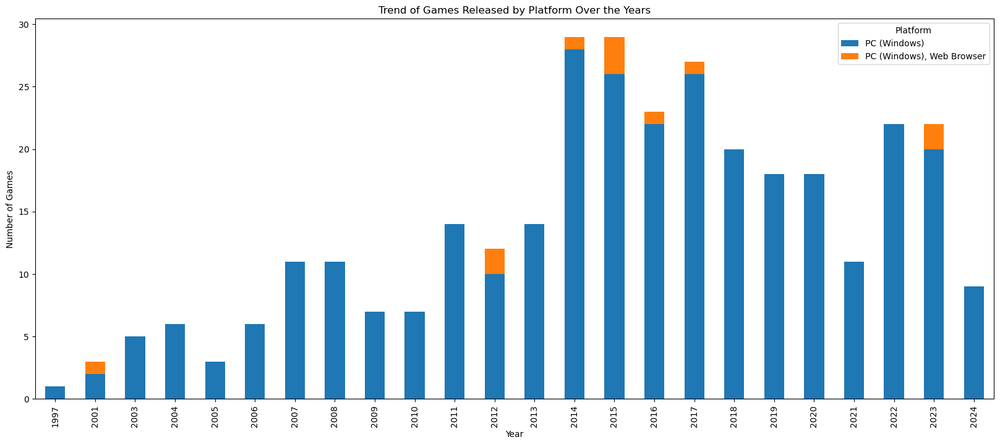

In [9]:
file = pd.read_csv('../vahid/Downloads/Free-to-play games.txt')
date_file = pd.DataFrame(file)



date_file['release_date'] = pd.to_datetime(date_file['release_date'], errors='coerce')  # تبدیل ستون تاریخ به فرمت datetime و استخراج سال
date_file['year'] = date_file['release_date'].dt.year


date_file = date_file.dropna(subset=['year'])  # حذف ردیف‌هایی که تاریخ نامعتبر دارند


platform_year_trend = date_file.groupby(['year', 'platform']).size().unstack(fill_value=0) # گروه‌بندی بر اساس سال و پلتفرم و شمارش تعداد بازی‌ها

print(platform_year_trend)

platform_year_trend.plot(kind='bar', stacked=True, figsize=(20, 8))
plt.title('Trend of Games Released by Platform Over the Years')
plt.xlabel('Year')
plt.ylabel('Number of Games')
plt.legend(title='Platform')
plt.show()


# genre_year_trend

genre  ARPG  Action  Action Game  Action RPG  Battle Royale  Card  Card Game  \
year                                                                           
1997      0       0            0           0              0     0          0   
2001      0       0            0           0              0     0          0   
2003      0       0            0           0              0     0          0   
2004      0       0            0           0              0     0          0   
2005      0       0            0           0              0     0          0   
2006      0       0            0           0              0     0          0   
2007      0       0            0           0              0     0          0   
2008      0       0            0           0              0     0          0   
2009      0       0            0           0              0     0          0   
2010      0       0            0           0              0     0          0   
2011      0       0            0        

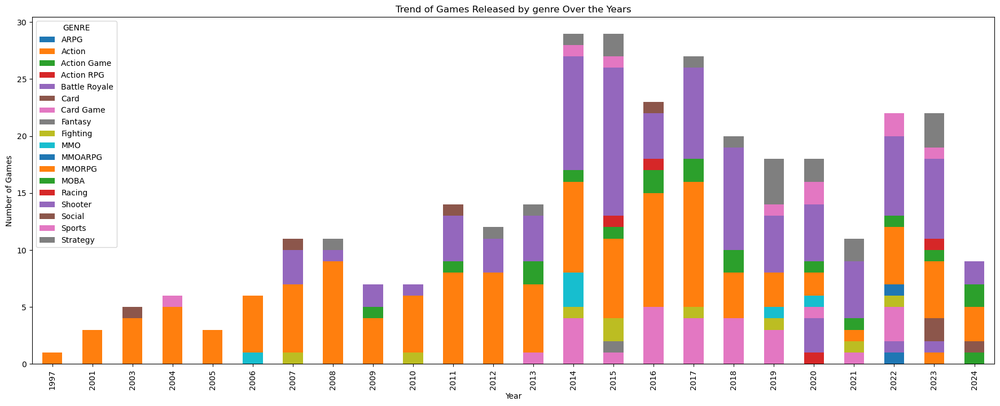

In [10]:


genre_year_trend = date_file.groupby(['year', 'genre']).size().unstack(fill_value=0)

print(genre_year_trend)

genre_year_trend.plot(kind='bar', stacked=True, figsize=(22, 8))
plt.title('Trend of Games Released by genre Over the Years')
plt.xlabel('Year')
plt.ylabel('Number of Games')
plt.legend(title='GENRE')
plt.show()

# publisher&developer_genre_trend

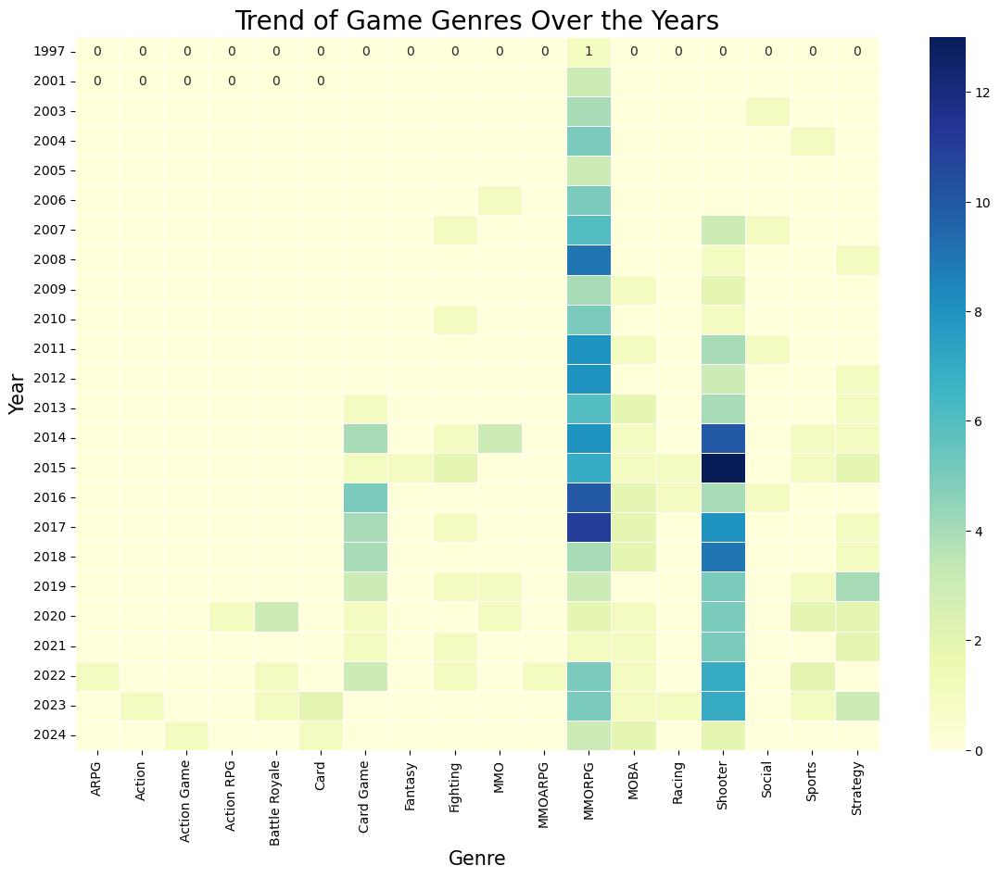

) missing from current font.\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 13 (
  fig.canvas.print_figure(bytes_io, **kw)


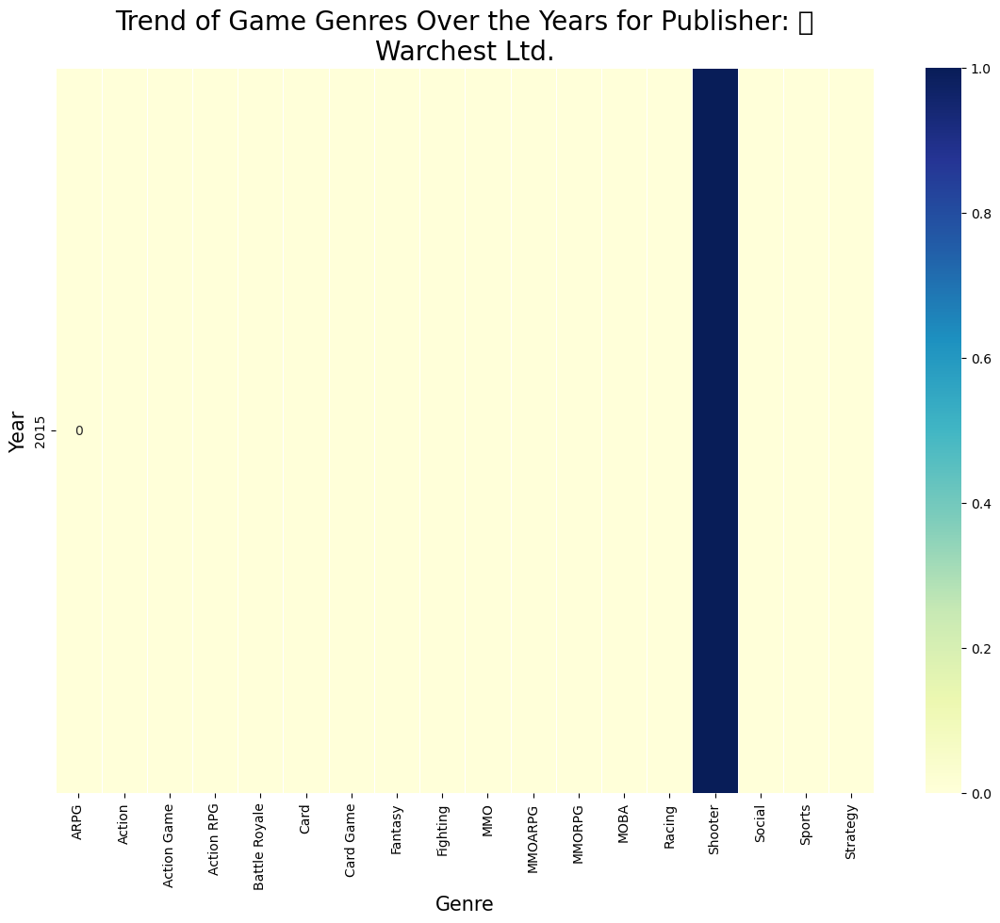

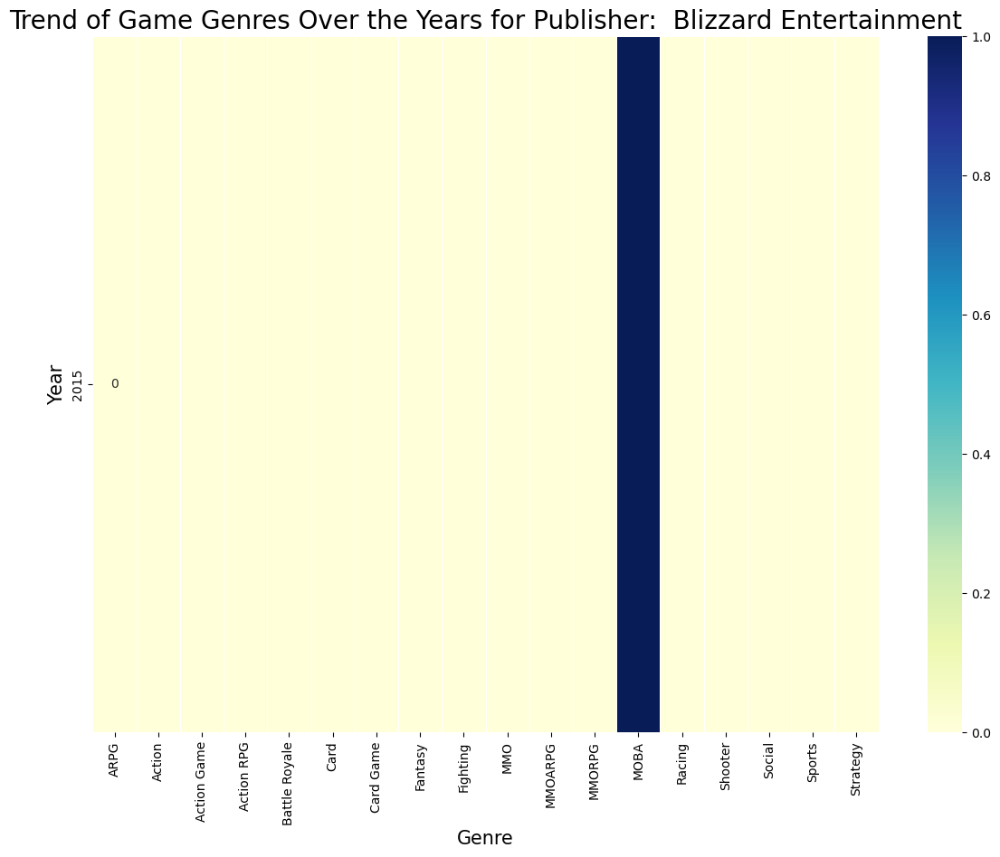

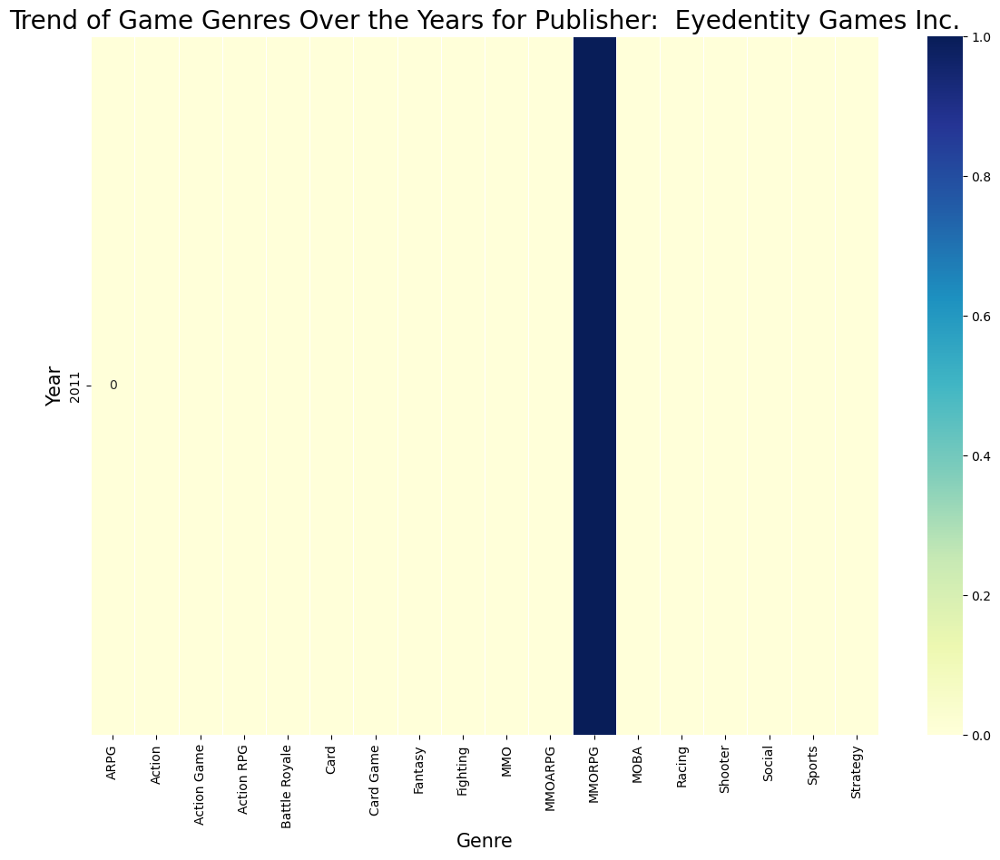

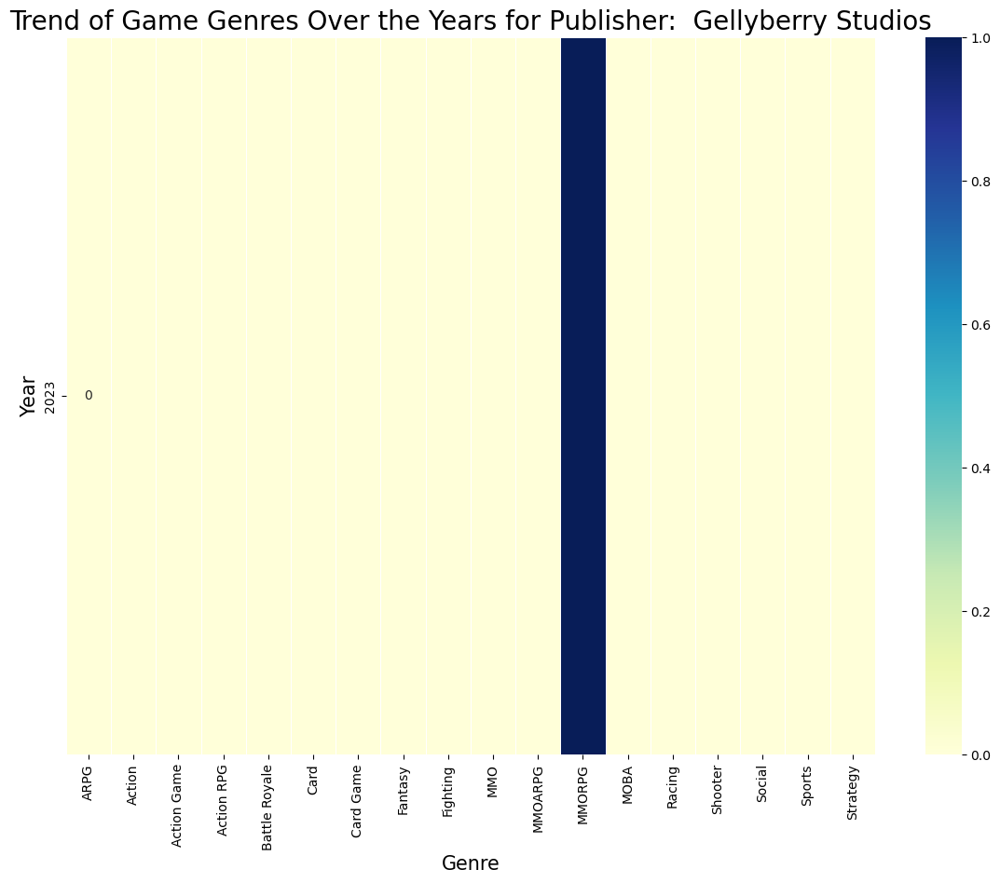

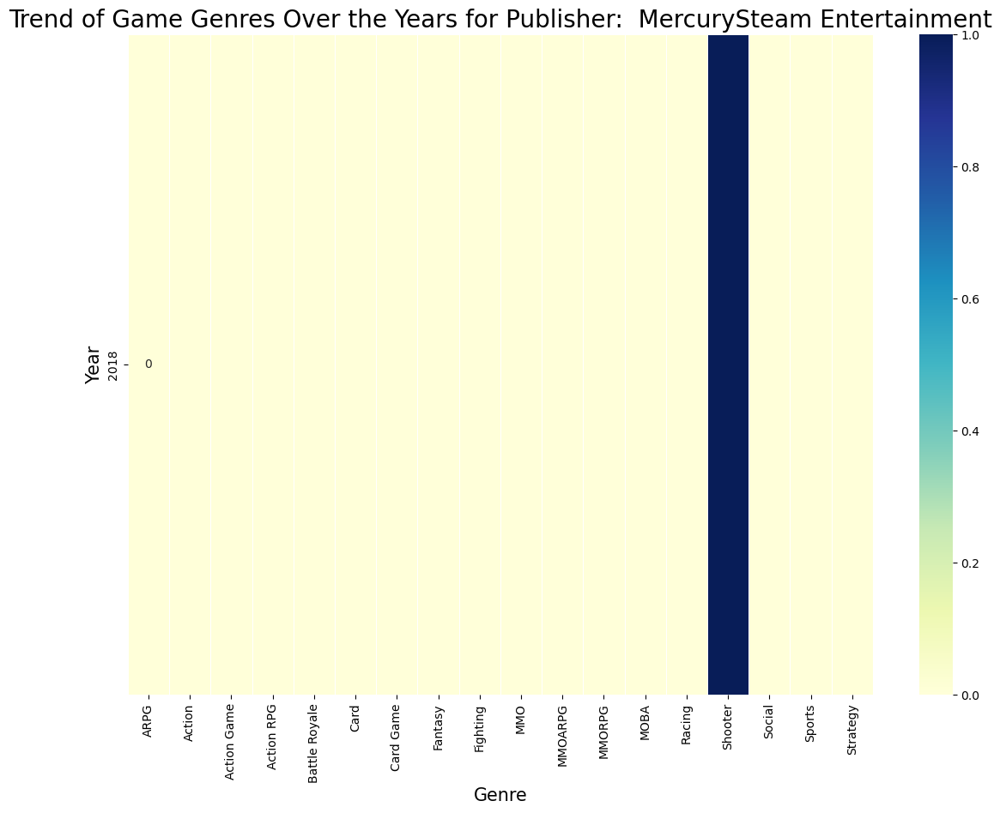

...

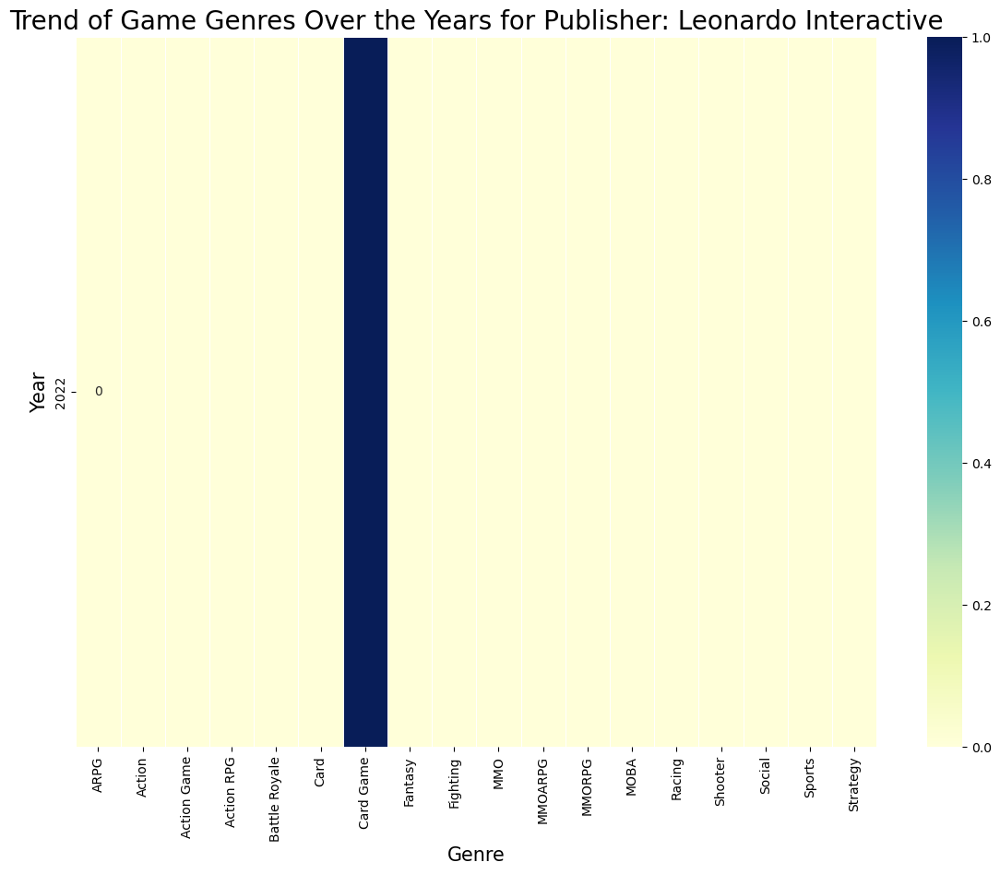

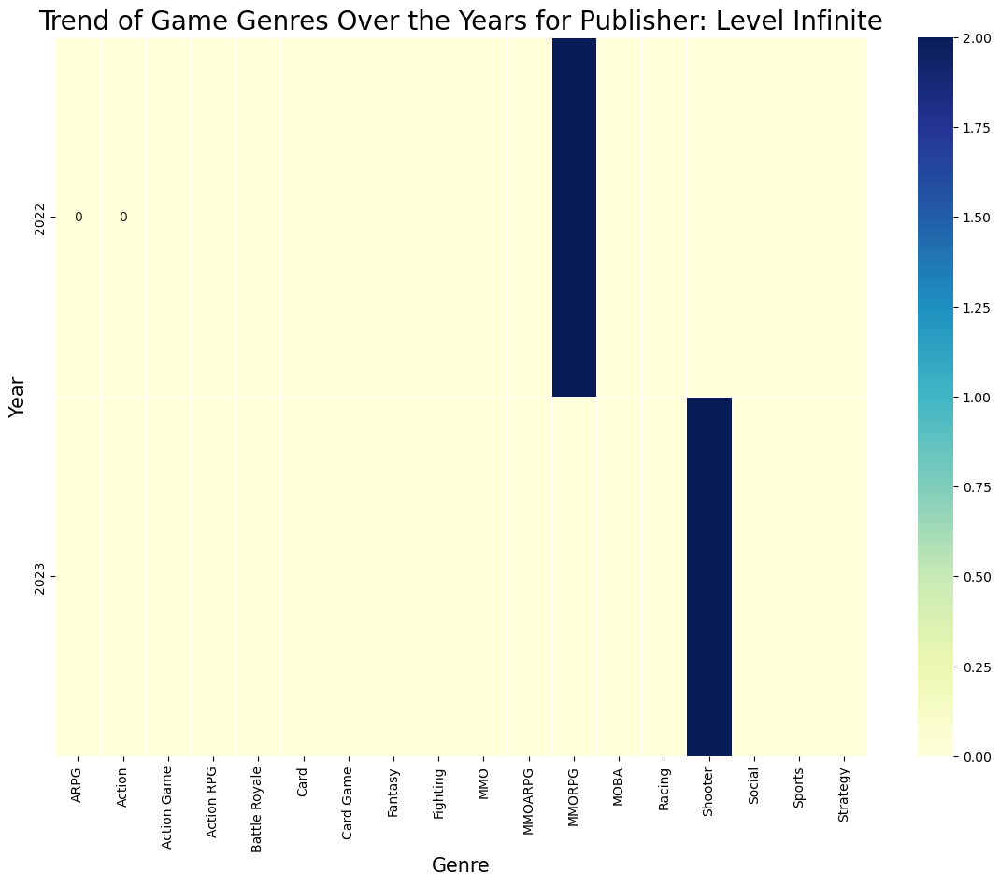

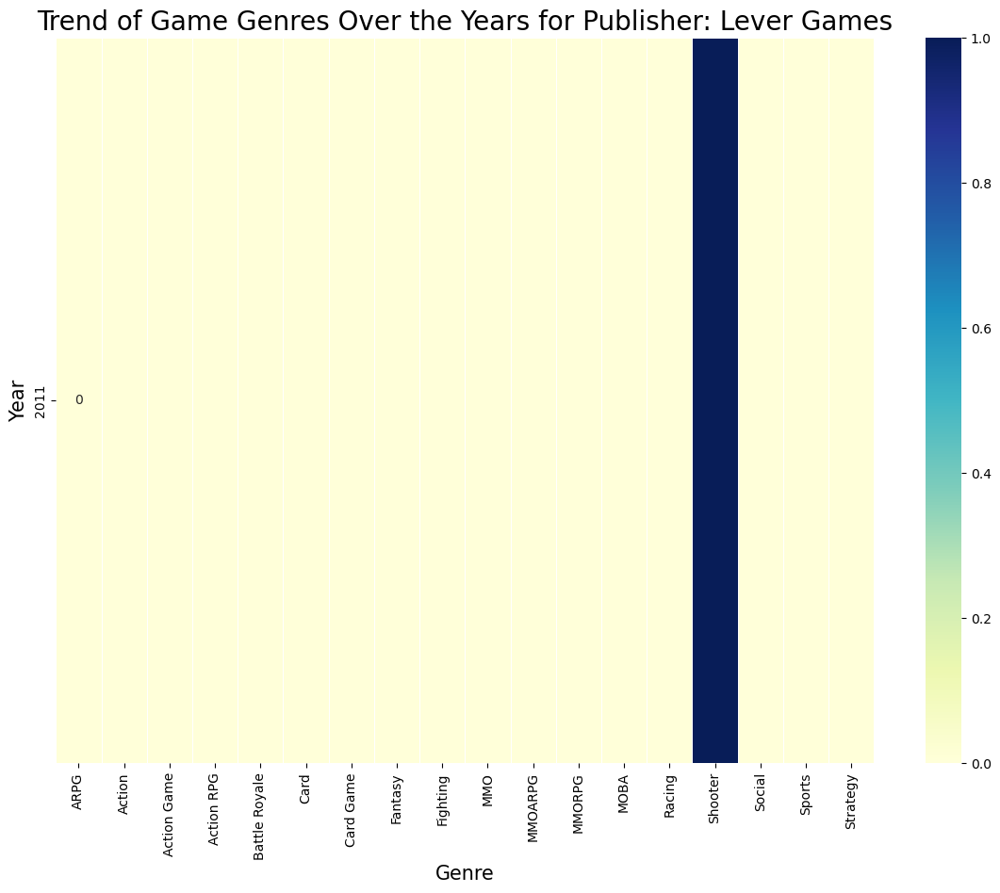

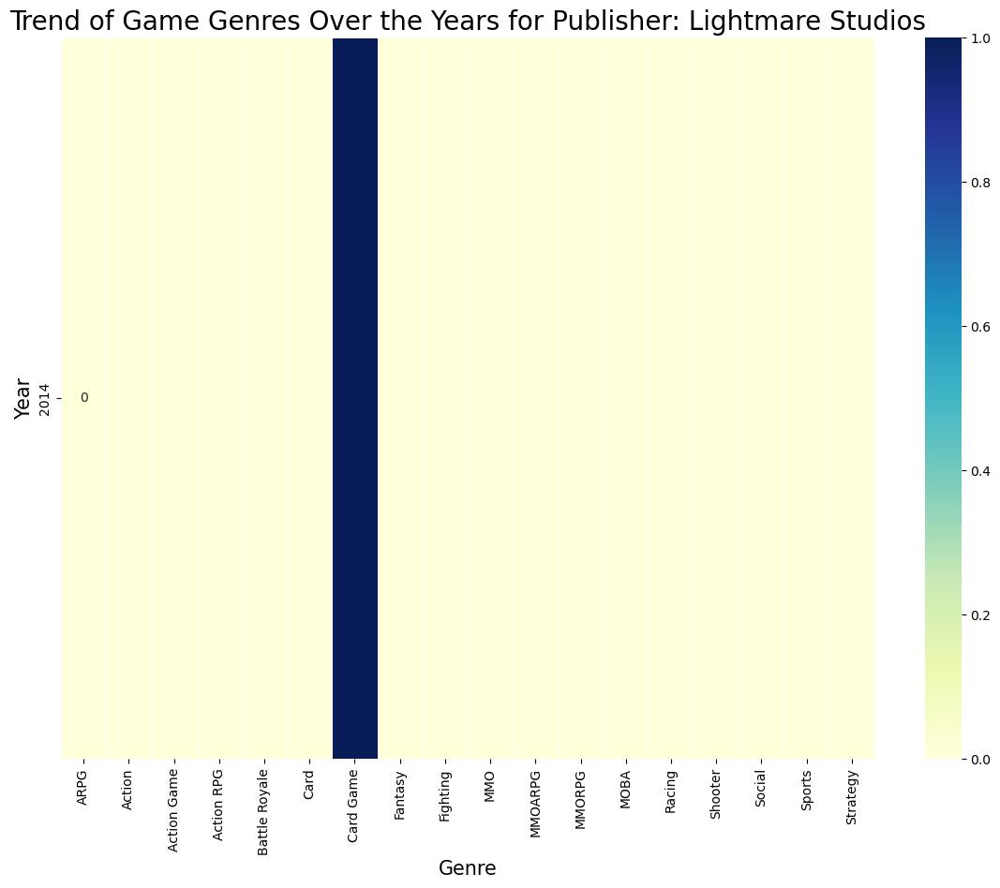

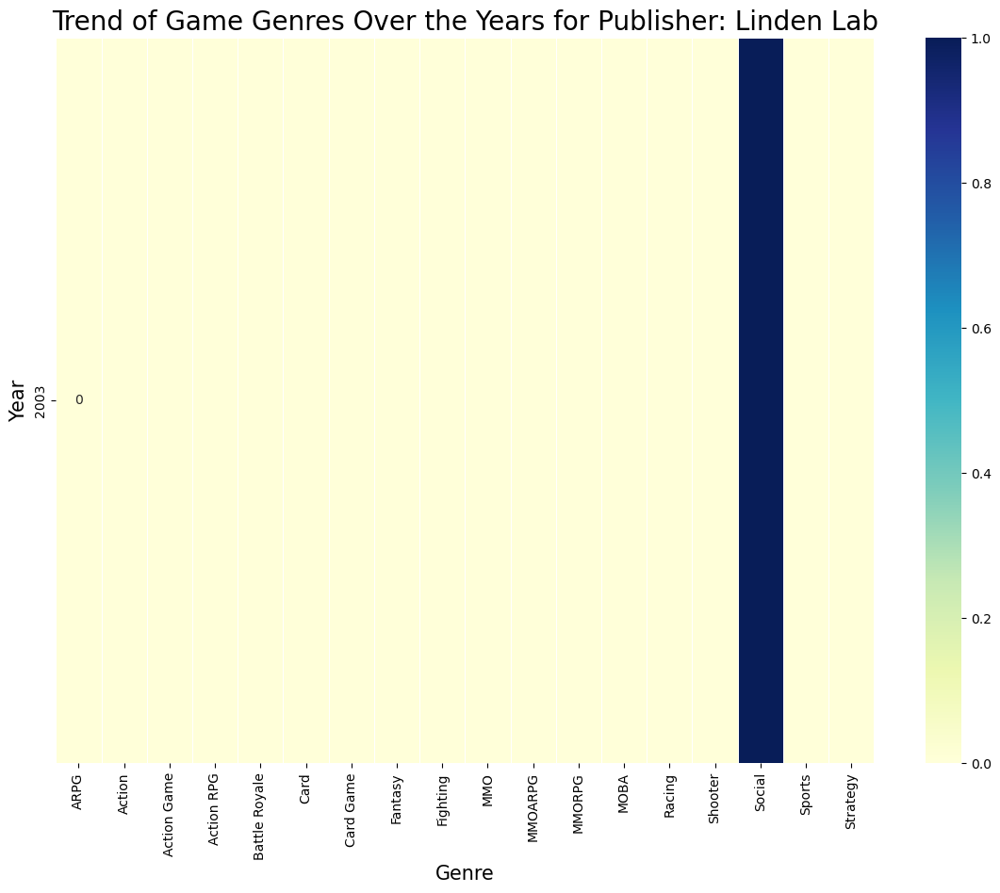

C:\Users\vahid\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 65286 (\N{FULLWIDTH AMPERSAND}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


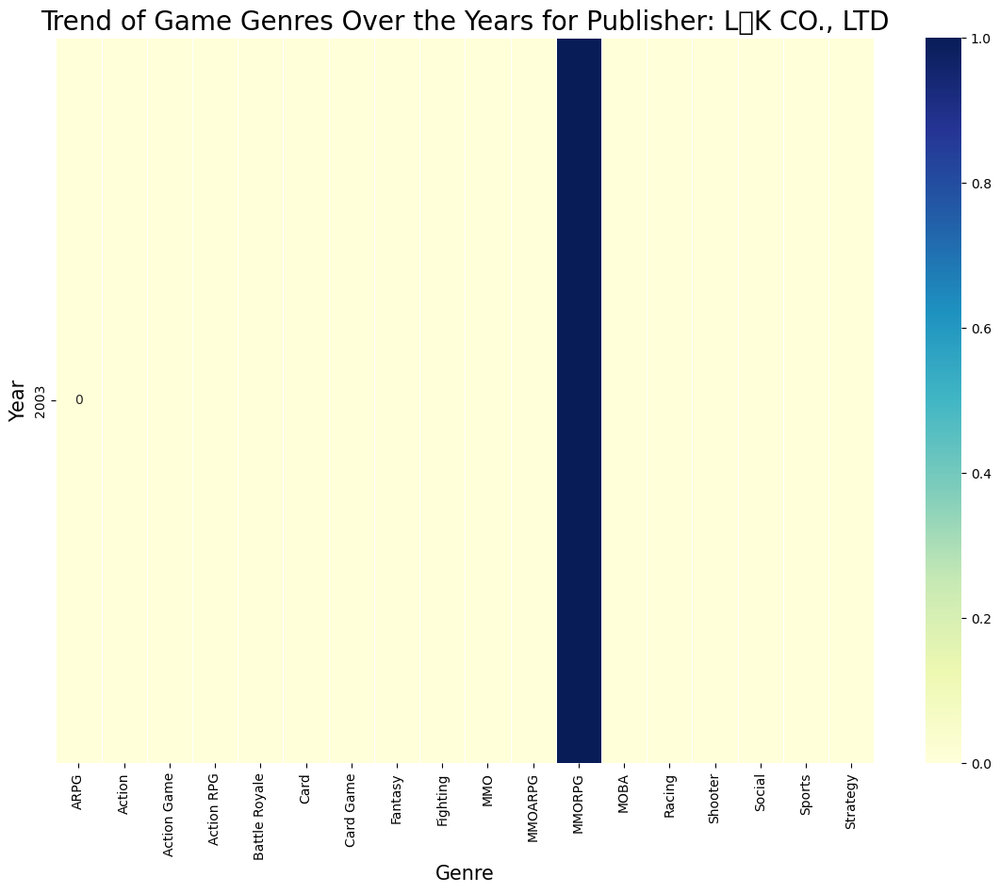

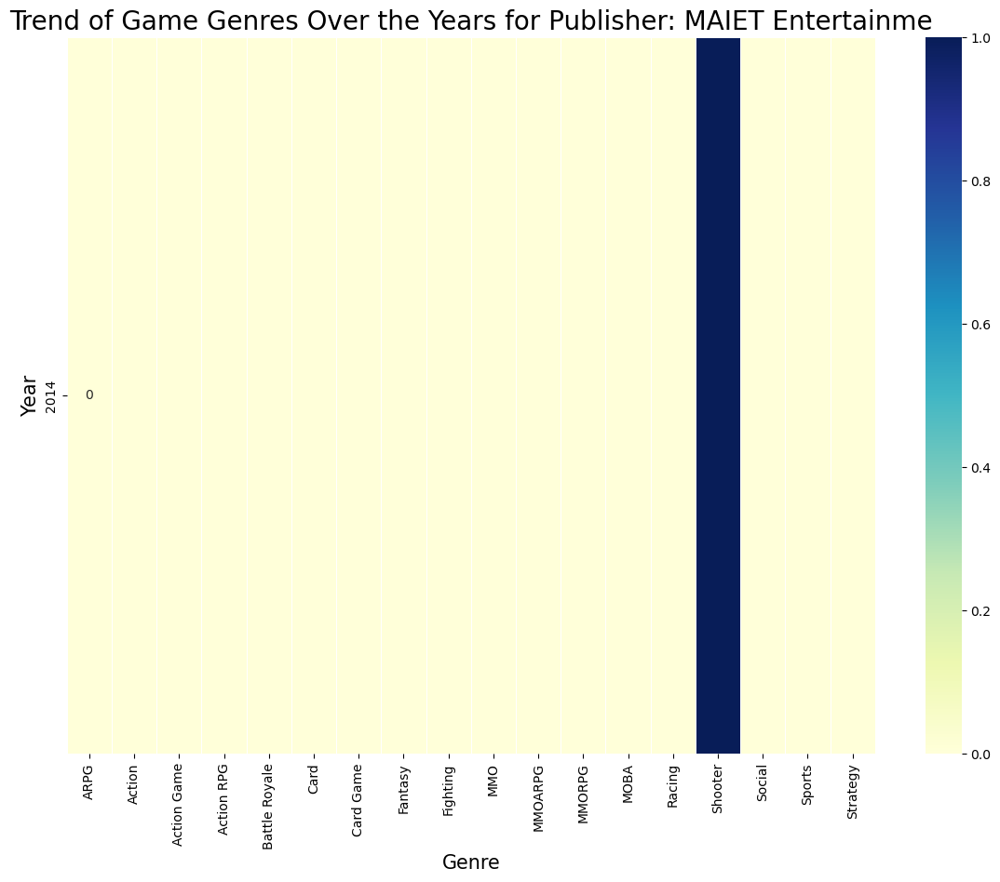

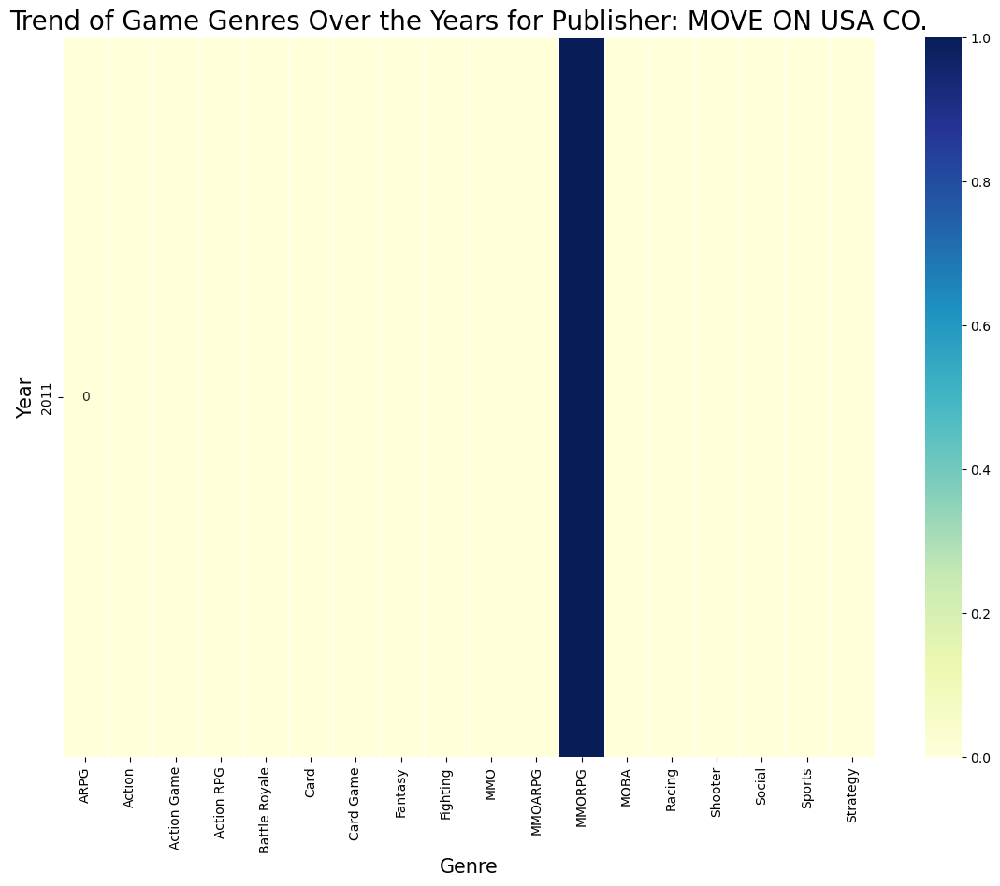

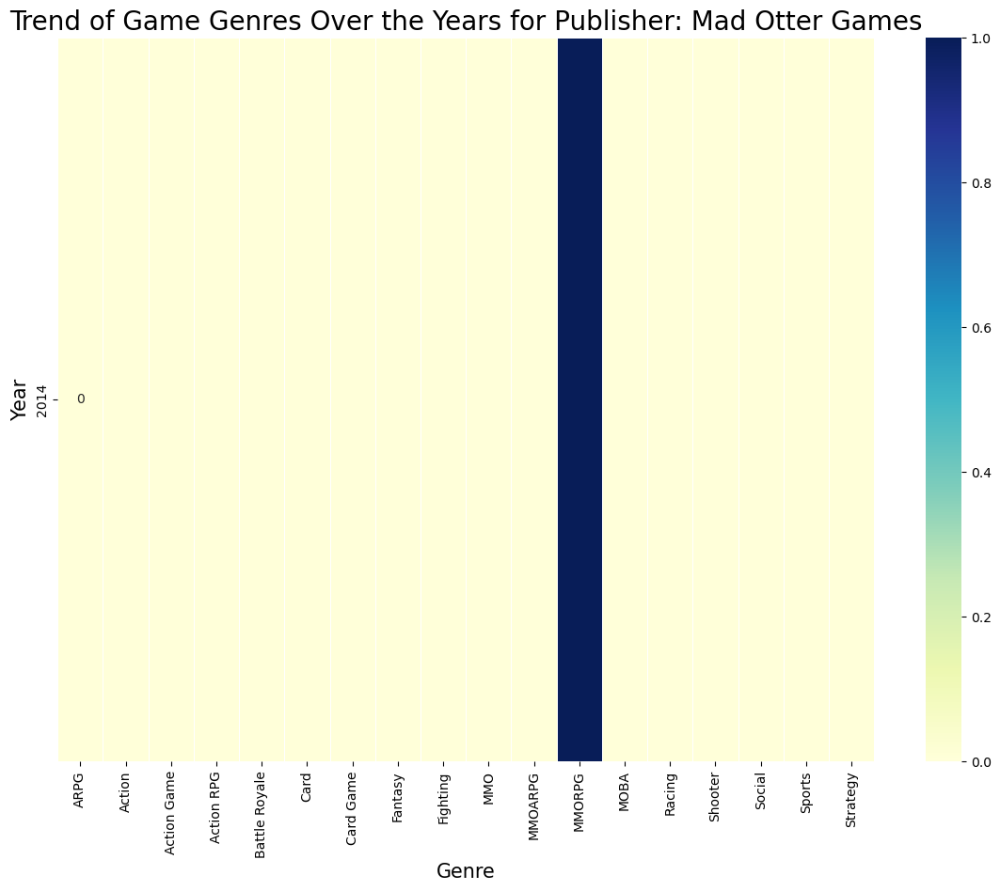

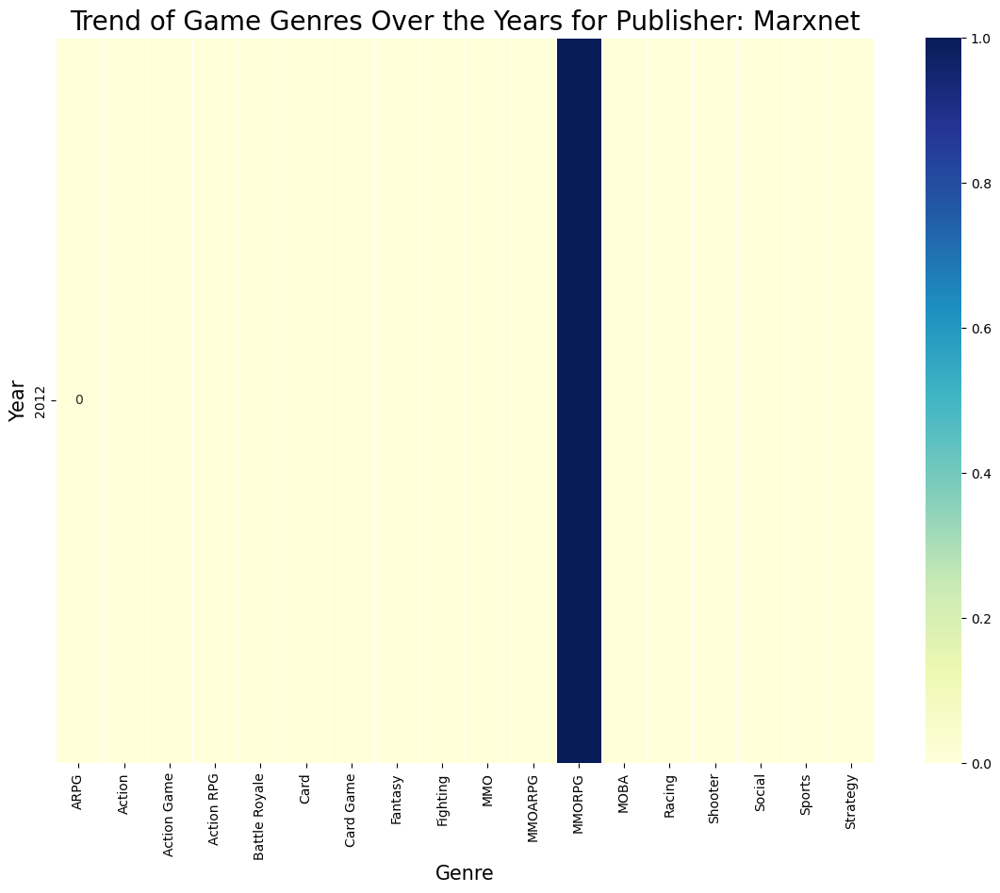

...

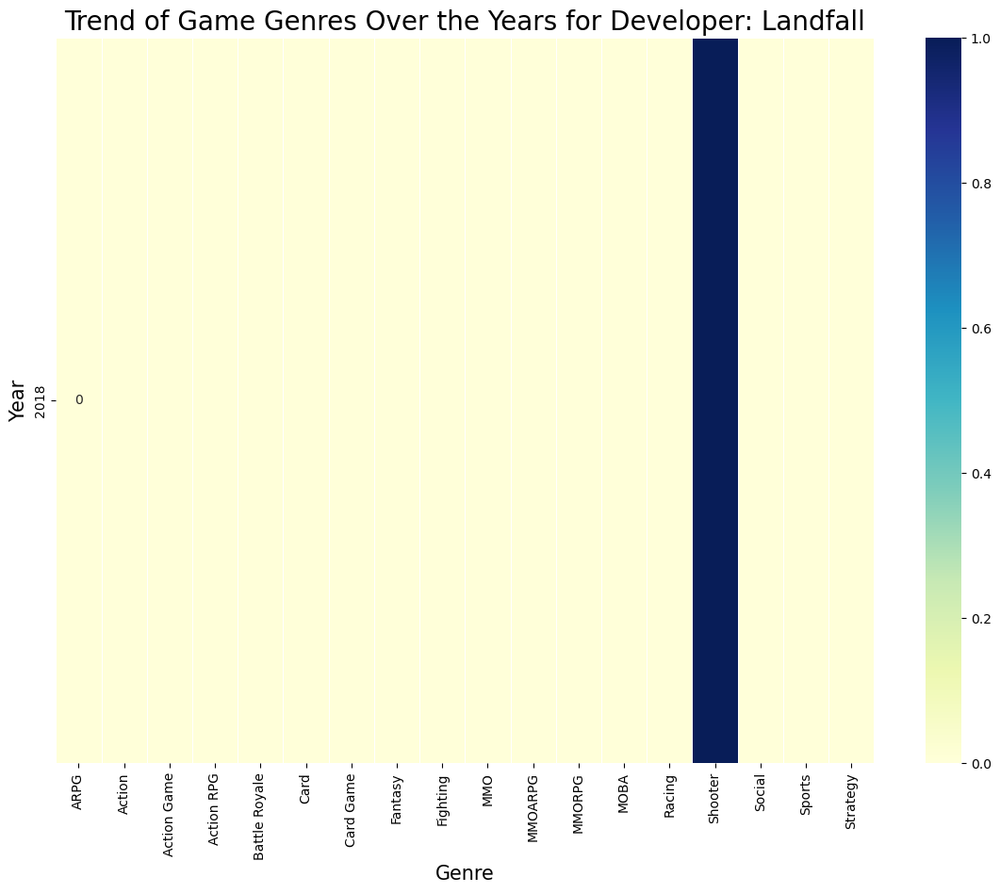

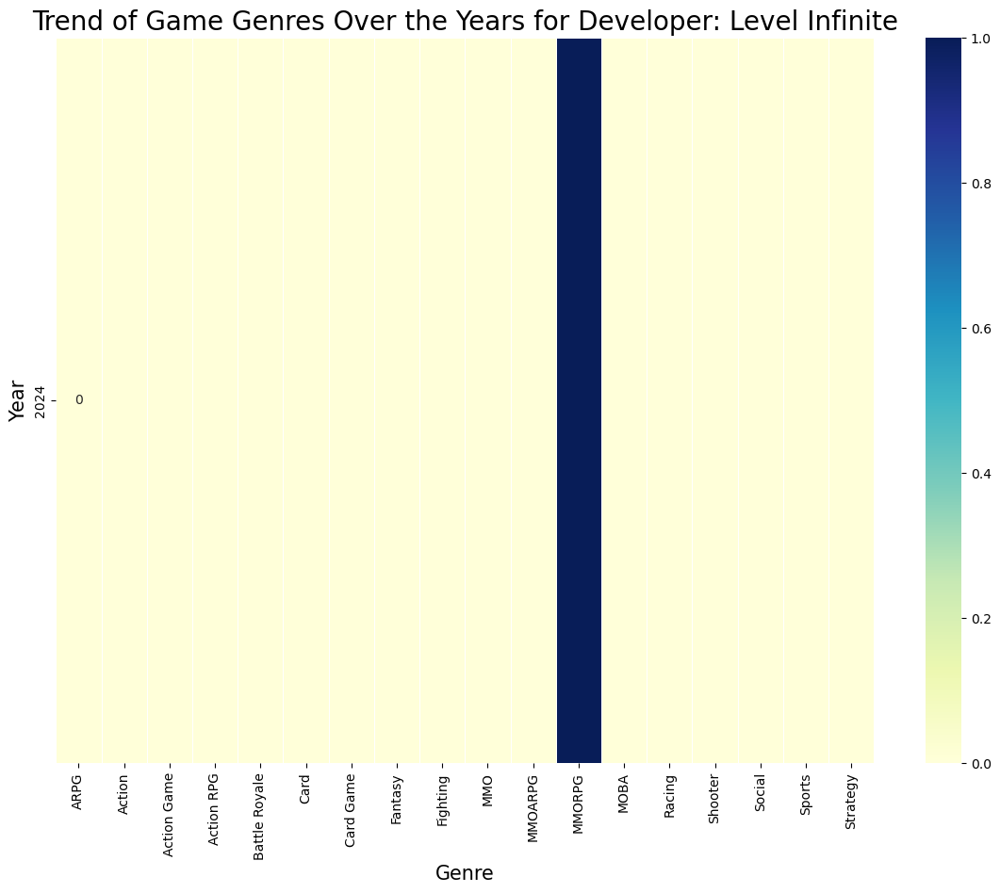

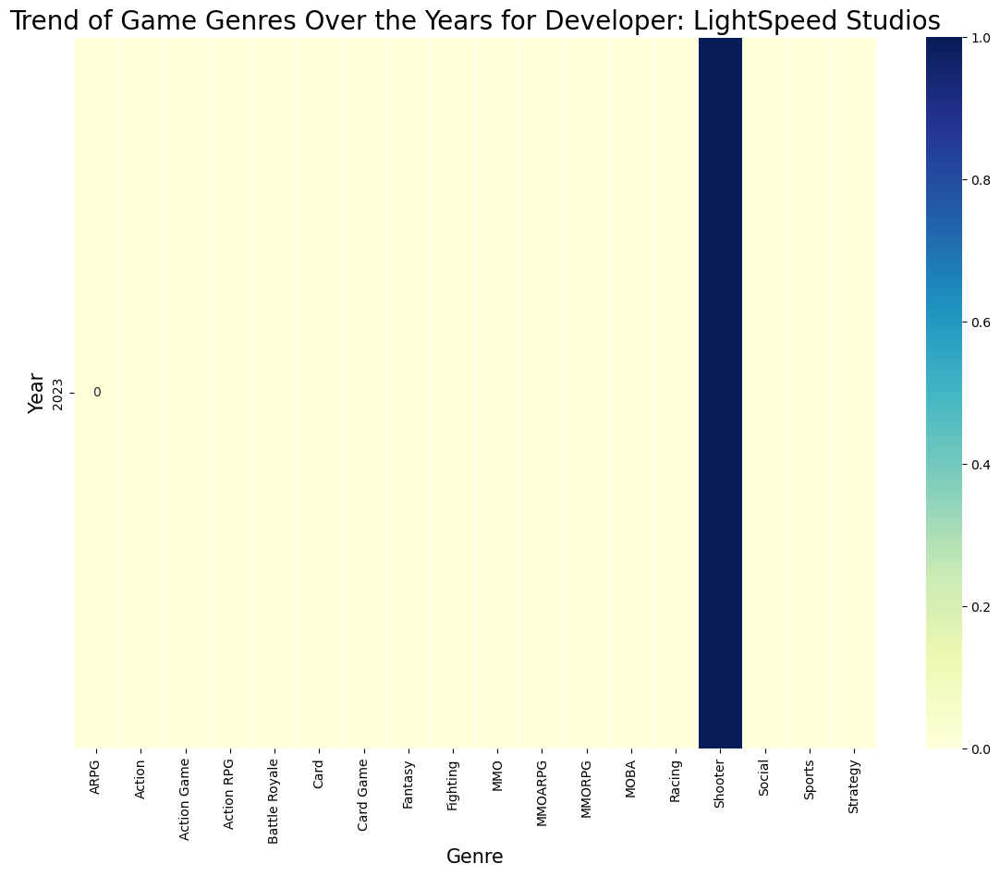

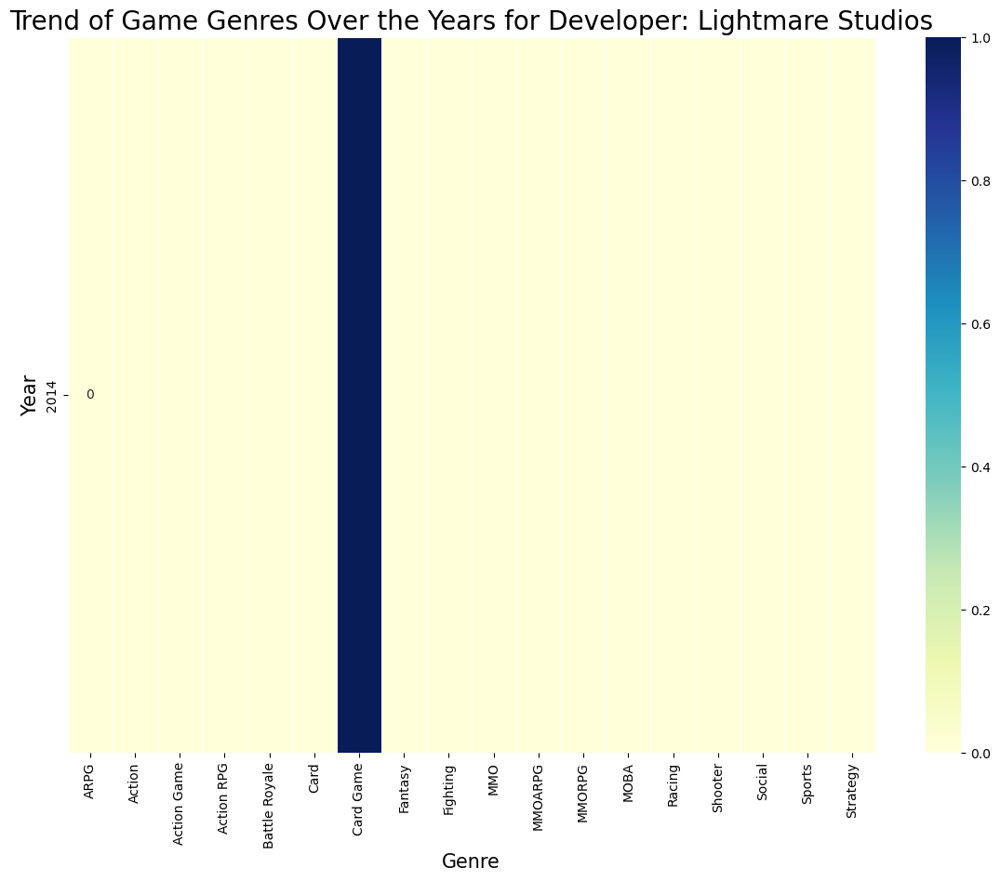

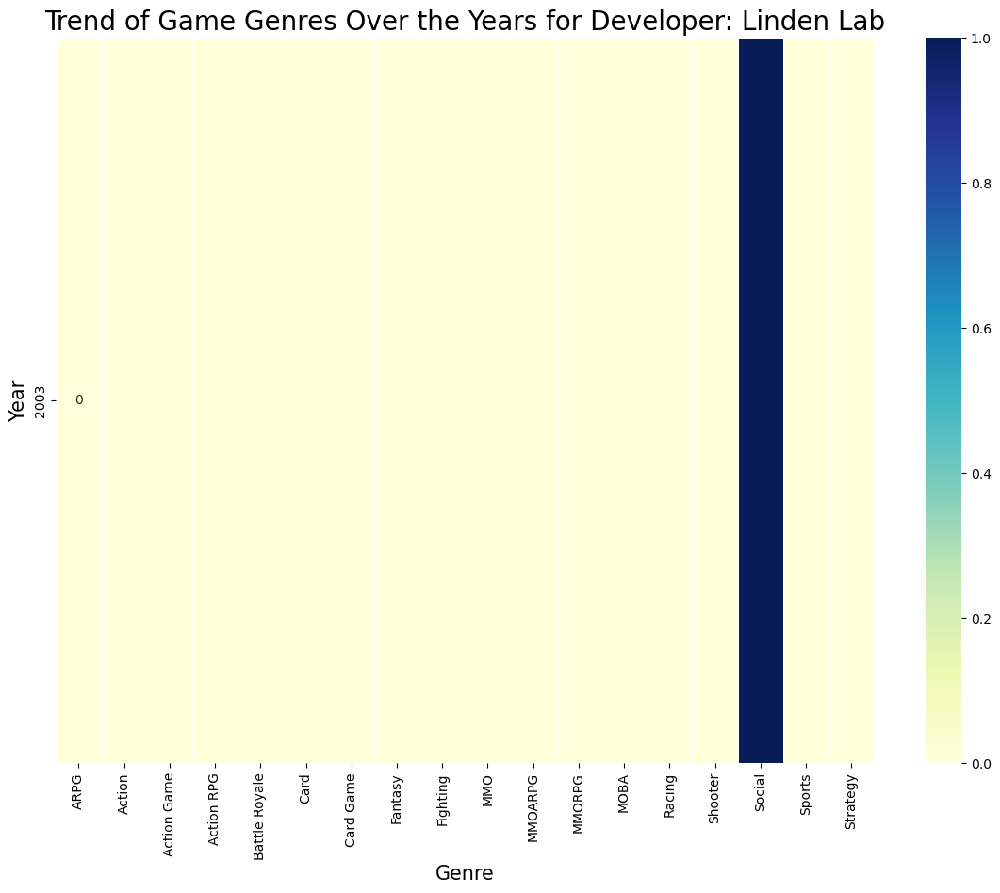

C:\Users\vahid\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 65286 (\N{FULLWIDTH AMPERSAND}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


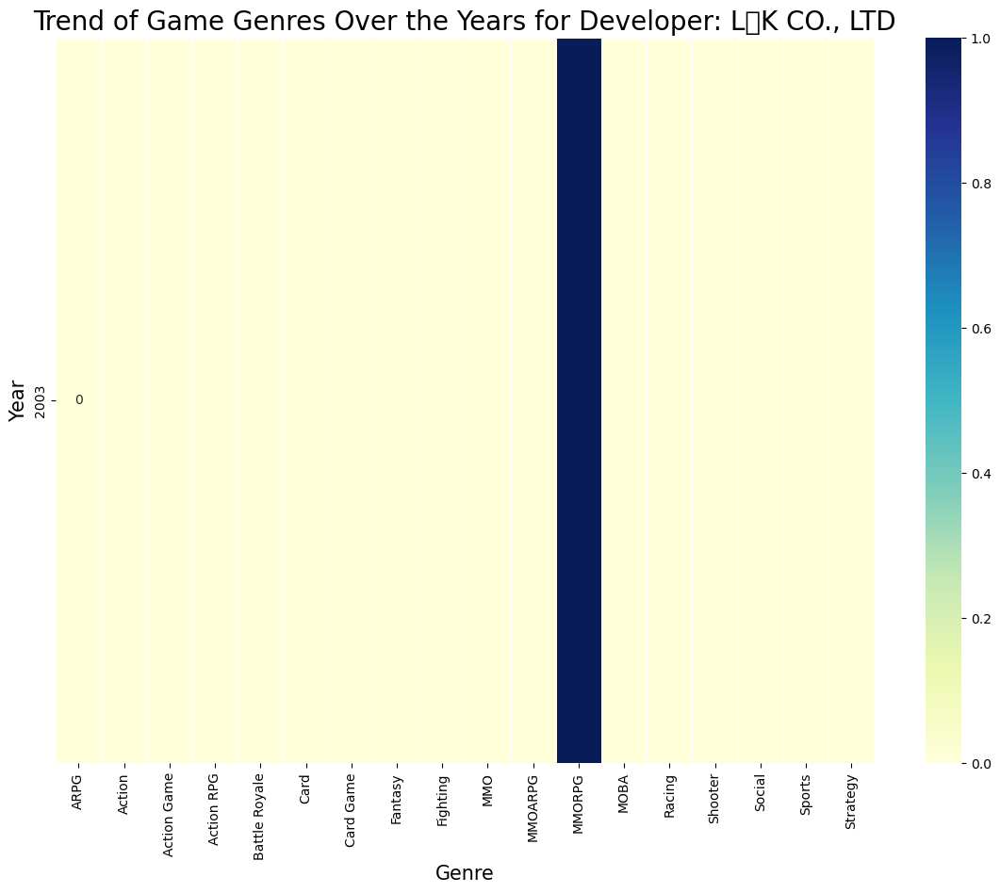

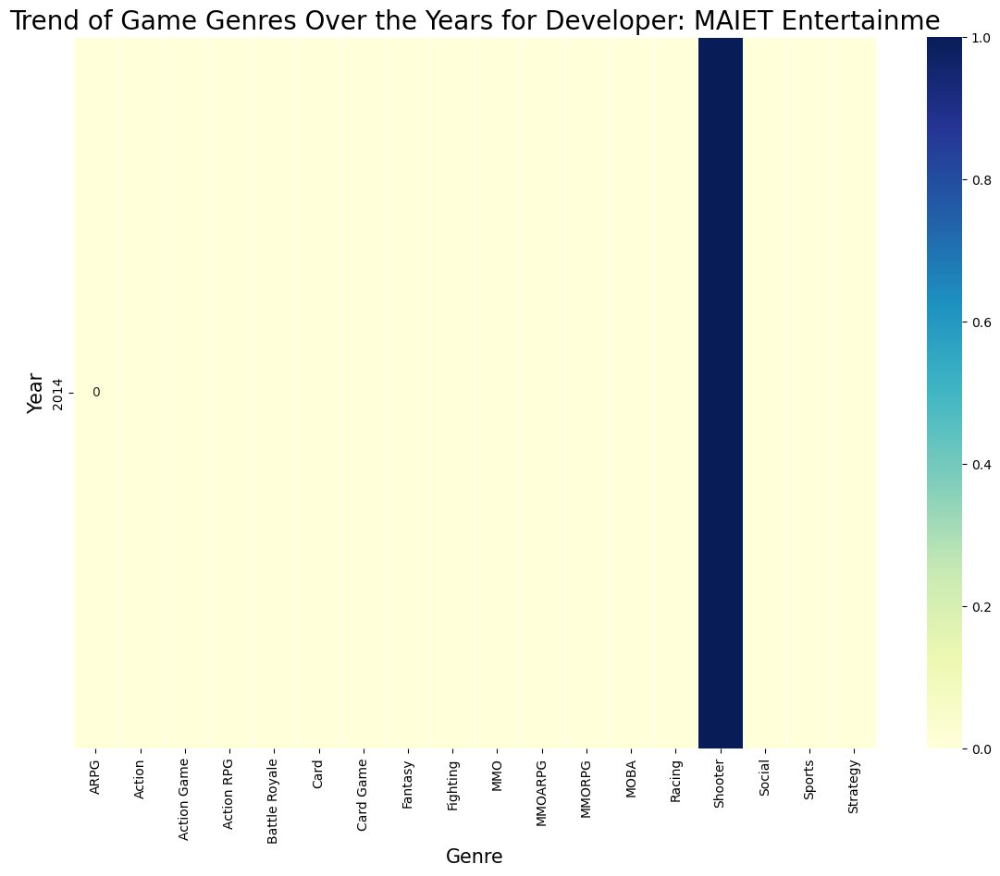

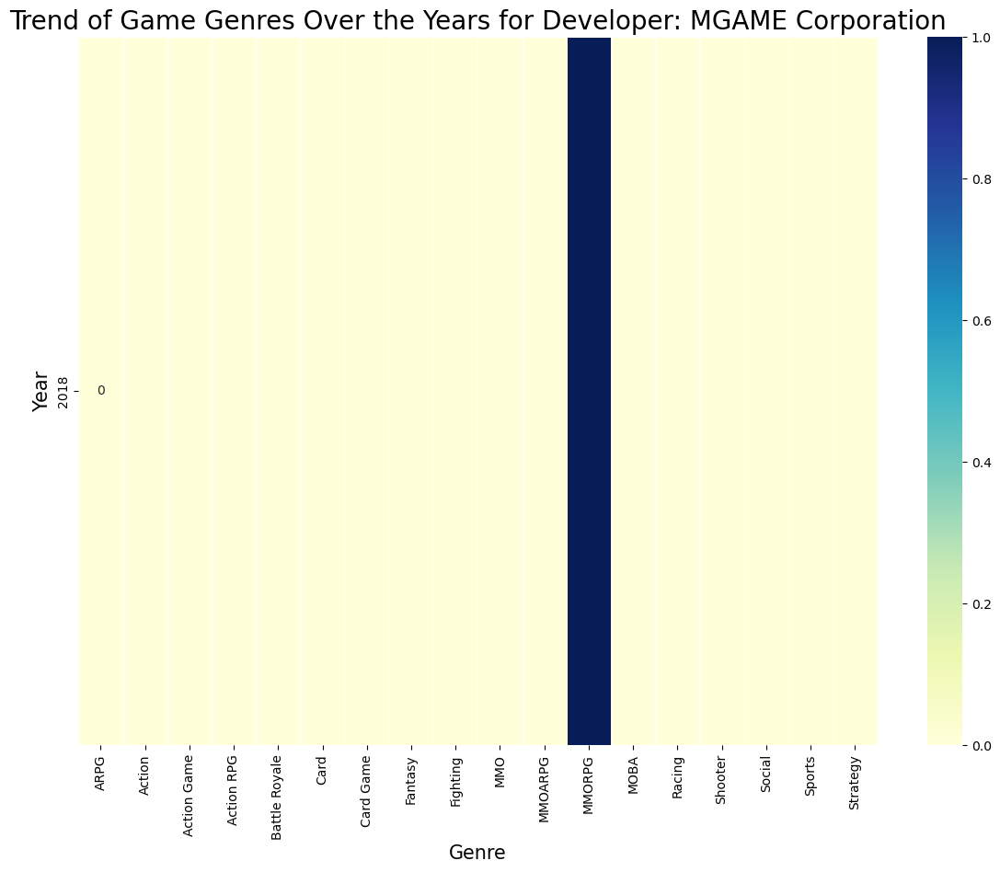

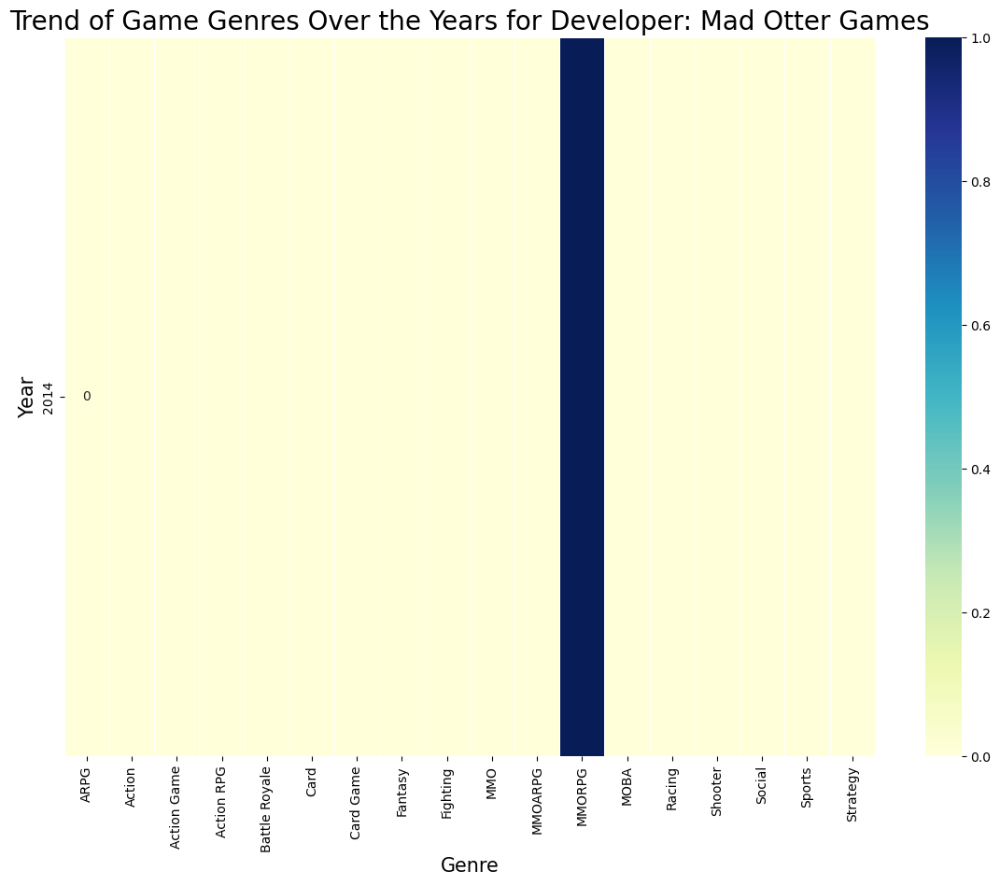

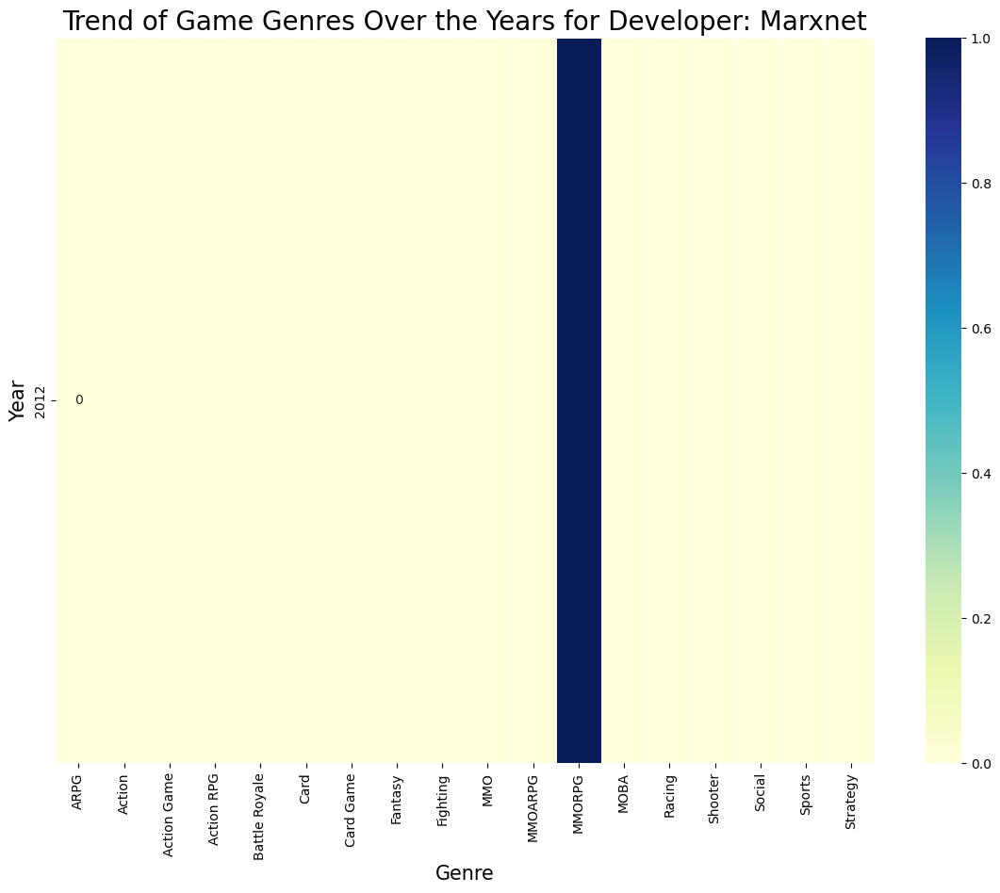

...

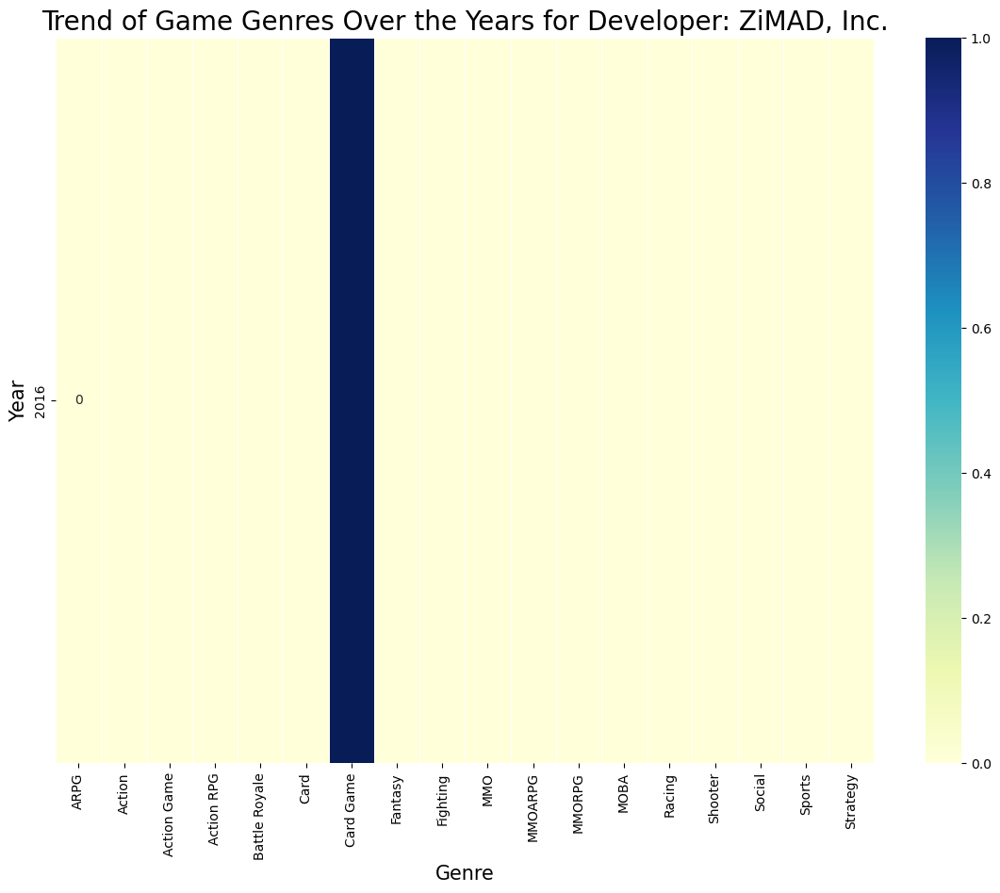

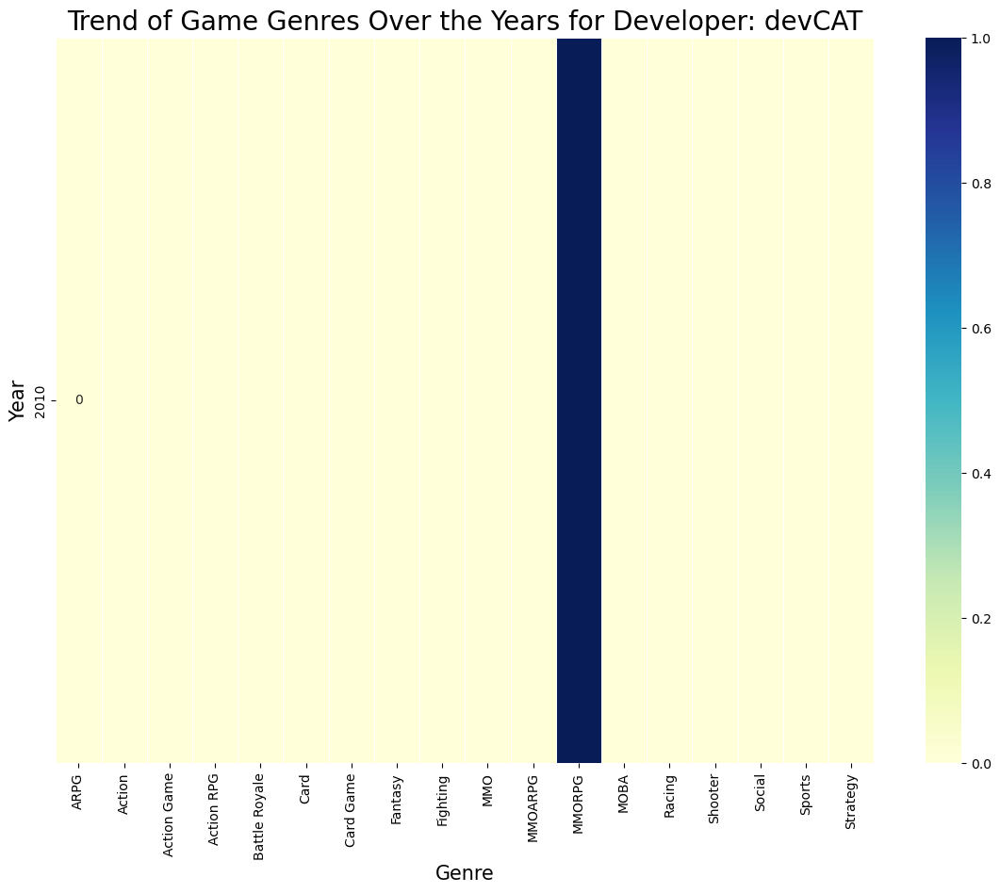

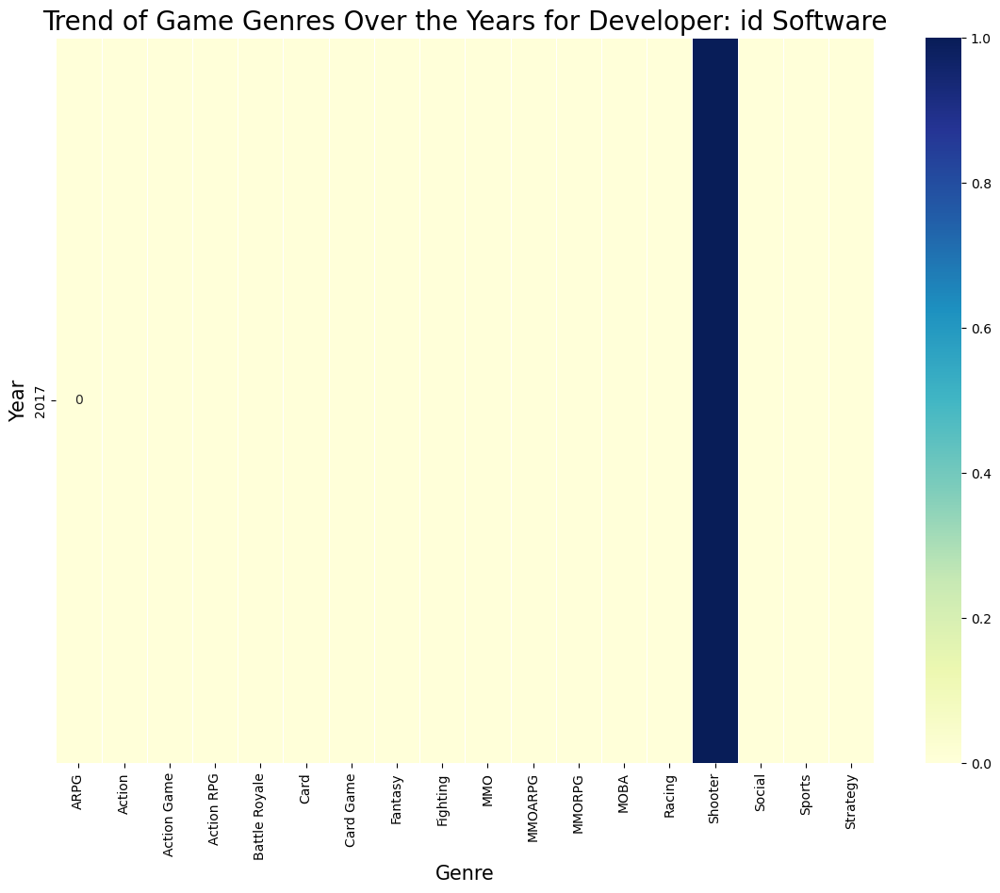

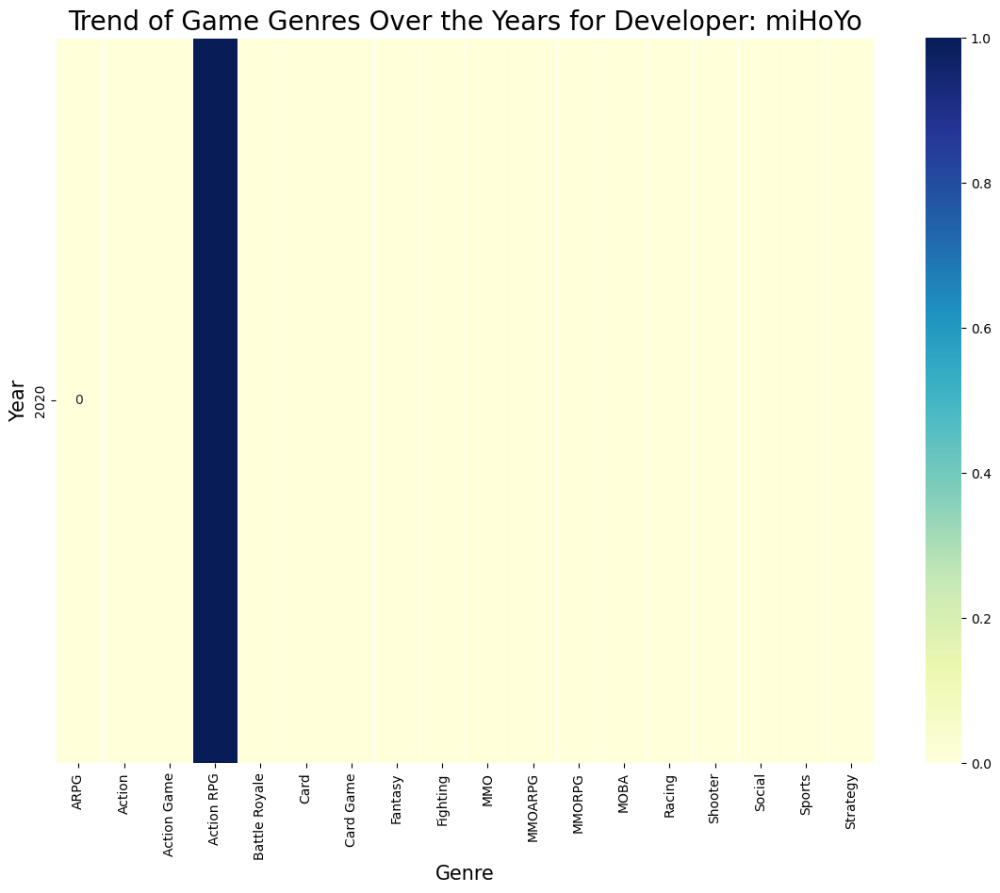

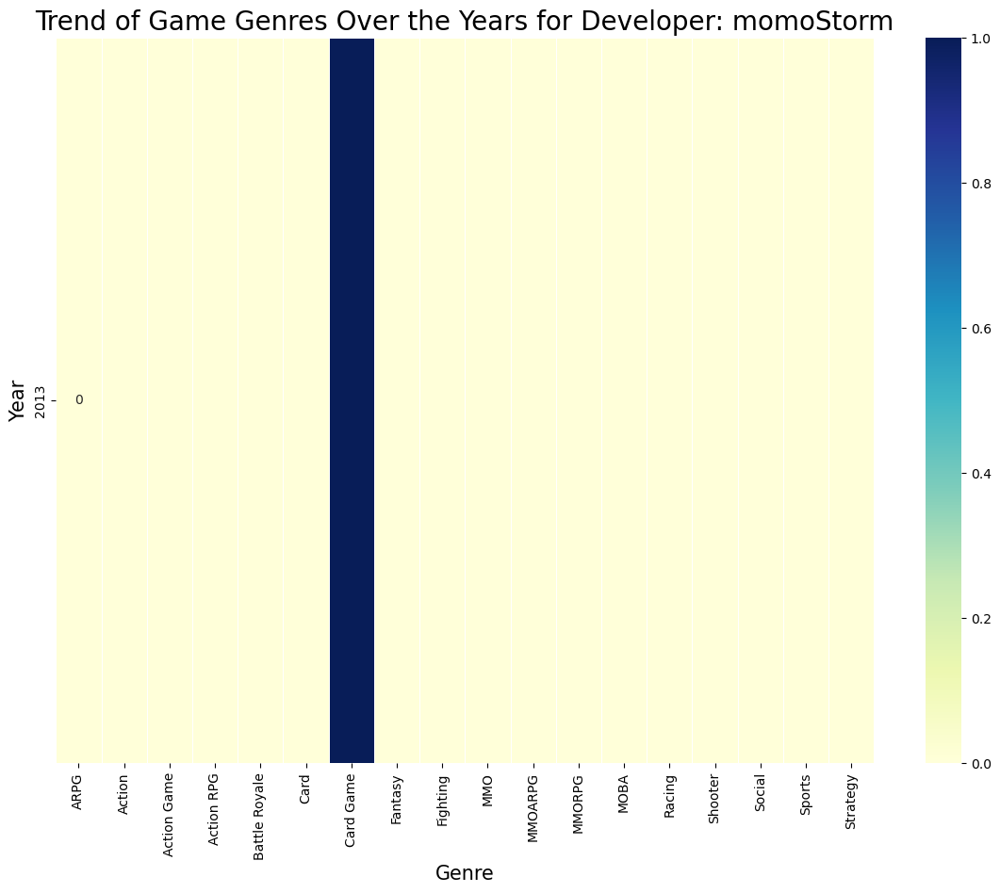

In [11]:

file_path = '../vahid/Downloads/Free-to-play games.txt'
df = pd.read_csv(file_path, encoding='utf-8')

df['release_date'] = pd.to_datetime(df['release_date'], errors='coerce')
df['year'] = df['release_date'].dt.year
df = df.dropna(subset=['year'])

df = df.dropna(subset=['publisher', 'genre', 'developer'])

genre_year_trend = df.groupby(['year', 'genre']).size().unstack(fill_value=0)



# ترسیم نمودار گرمایی برای ترند تغییرات ژانر بازی‌ها به صورت مجزا
plt.figure(figsize=(14, 10))
sns.heatmap(genre_year_trend, cmap='YlGnBu', linewidths=0.5, annot=True)
plt.title('Trend of Game Genres Over the Years', fontsize=20)
plt.xlabel('Genre', fontsize=15)
plt.ylabel('Year', fontsize=15)
plt.show()


publisher_genre_trend = df.groupby(['publisher', 'year', 'genre']).size().unstack(fill_value=0).reset_index()
publisher_genre_trend = publisher_genre_trend.melt(id_vars=['publisher', 'year'], var_name='genre', value_name='count')

# ترسیم نمودار گرمایی برای ترند تغییرات ژانر بازی‌ها به تفکیک ناشر
for publisher in publisher_genre_trend['publisher'].unique():
    publisher_data = publisher_genre_trend[publisher_genre_trend['publisher'] == publisher].pivot(index='year', columns='genre', values='count').fillna(0)
    plt.figure(figsize=(14, 10))
    sns.heatmap(publisher_data, cmap='YlGnBu', linewidths=0.5, annot=True)
    plt.title(f'Trend of Game Genres Over the Years for Publisher: {publisher}', fontsize=20)
    plt.xlabel('Genre', fontsize=15)
    plt.ylabel('Year', fontsize=15)
    plt.show()


developer_genre_trend = df.groupby(['developer', 'year', 'genre']).size().unstack(fill_value=0).reset_index()
developer_genre_trend = developer_genre_trend.melt(id_vars=['developer', 'year'], var_name='genre', value_name='count')

# ترسیم نمودار گرمایی برای ترند تغییرات ژانر بازی‌ها به تفکیک توسعه‌دهنده
for developer in developer_genre_trend['developer'].unique():
    developer_data = developer_genre_trend[developer_genre_trend['developer'] == developer].pivot(index='year', columns='genre', values='count').fillna(0)
    plt.figure(figsize=(14, 10))
    sns.heatmap(developer_data, cmap='YlGnBu', linewidths=0.5, annot=True)
    plt.title(f'Trend of Game Genres Over the Years for Developer: {developer}', fontsize=20)
    plt.xlabel('Genre', fontsize=15)
    plt.ylabel('Year', fontsize=15)
    plt.show()


# Keywords Counts by Genre

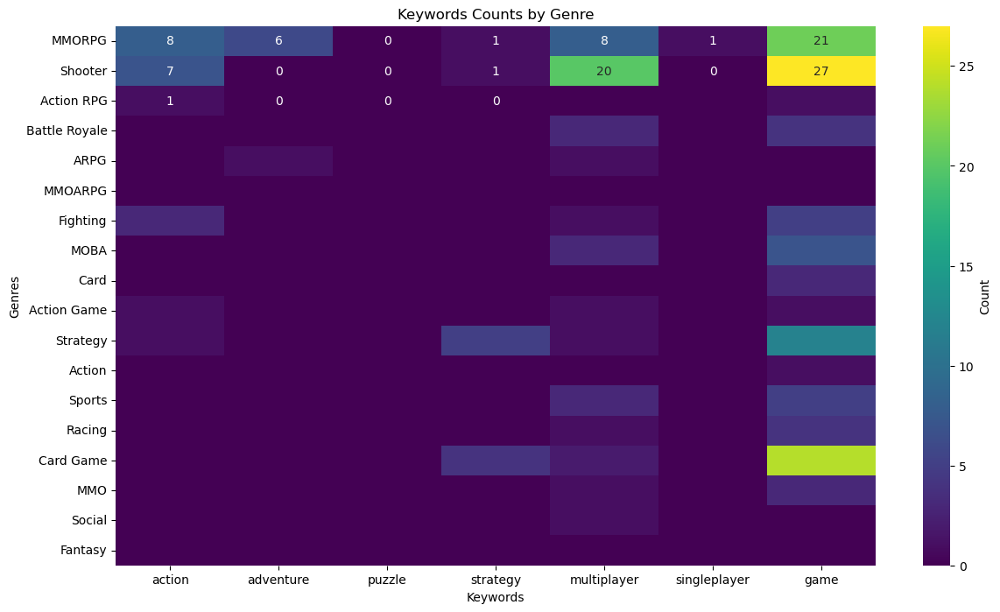

In [17]:


keywords = ['action', 'adventure', 'puzzle', 'strategy', 'multiplayer', 'singleplayer','game']

# تابعی برای تمیز کردن و جداسازی کلمات از متن
def preprocess_text(text):
    text = text.lower()  
    text = re.sub(r'[^\w\s]', '', text)  
    words = text.split()  
    return words

df['cleaned_description'] = df['short_description'].dropna().apply(preprocess_text)

# شمارش تکرار کلمات کلیدی در هر ژانر
keyword_counts = {keyword: [] for keyword in keywords}
for genre in df['genre'].unique():
    genre_descriptions = df[df['genre'] == genre]['cleaned_description']
    genre_all_words = [word for words in genre_descriptions for word in words]
    genre_word_counter = Counter(genre_all_words)
    for keyword in keywords:
        keyword_counts[keyword].append(genre_word_counter[keyword])

# ایجاد DataFrame برای نمایش تکرار کلمات کلیدی به تفکیک ژانر
keyword_counts_df = pd.DataFrame(keyword_counts, index=df['genre'].unique())

# ترسیم نمودار Heatmap برای نمایش تکرار کلمات کلیدی به تفکیک ژانر
plt.figure(figsize=(14, 8))
sns.heatmap(keyword_counts_df, annot=True, cmap='viridis', fmt='d', cbar_kws={'label': 'Count'})
plt.title('Keywords Counts by Genre')
plt.xlabel('Keywords')
plt.ylabel('Genres')
plt.show()
